In [56]:
#from google.colab import drive
#drive.mount('/content/drive')

#root = '/content/drive/MyDrive/projects Data Science/MOA/'

In [57]:
# module
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

## 1. Dataset

### 1.1 input table

In [58]:
df = pd.read_csv('creditcardmarketing-bbm.csv')

### 1.2 Table Summary

In [59]:
print('Credit Card Maeketing BBM:', df.shape[0], "rows and", df.shape[1],'columns')

Credit Card Maeketing BBM: 18000 rows and 17 columns


### 1.3 Table Setting

In [60]:
pd.set_option('display.max_columns',None)
pd.set_option('display.max_rows',None)

## 2. Data Understanding

### 2.1 Check Data

In [61]:
df.head(3)

,Customer Number,Offer Accepted,Reward,Mailer Type,Income Level,# Bank Accounts Open,Overdraft Protection,Credit Rating,# Credit Cards Held,# Homes Owned,Household Size,Own Your Home,Average Balance,Q1 Balance,Q2 Balance,Q3 Balance,Q4 Balance
0,1,No,Air Miles,Letter,High,1,No,High,2,1,4,No,1160.75,1669.0,877.0,1095.0,1002.0
1,2,No,Air Miles,Letter,Medium,1,No,Medium,2,2,5,Yes,147.25,39.0,106.0,78.0,366.0
2,3,No,Air Miles,Postcard,High,2,No,Medium,2,1,2,Yes,276.50,367.0,352.0,145.0,242.0


In [62]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18000 entries, 0 to 17999
Data columns (total 17 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Customer Number       18000 non-null  int64  
 1   Offer Accepted        18000 non-null  object 
 2   Reward                18000 non-null  object 
 3   Mailer Type           18000 non-null  object 
 4   Income Level          18000 non-null  object 
 5   # Bank Accounts Open  18000 non-null  int64  
 6   Overdraft Protection  18000 non-null  object 
 7   Credit Rating         18000 non-null  object 
 8   # Credit Cards Held   18000 non-null  int64  
 9   # Homes Owned         18000 non-null  int64  
 10  Household Size        18000 non-null  int64  
 11  Own Your Home         18000 non-null  object 
 12  Average Balance       17976 non-null  float64
 13  Q1 Balance            17976 non-null  float64
 14  Q2 Balance            17976 non-null  float64
 15  Q3 Balance         

In [63]:
df.describe()

,Customer Number,# Bank Accounts Open,# Credit Cards Held,# Homes Owned,Household Size,Average Balance,Q1 Balance,Q2 Balance,Q3 Balance,Q4 Balance
count,18000.000000,18000.000000,18000.000000,18000.000000,18000.000000,17976.000000,17976.000000,17976.000000,17976.000000,17976.000000
mean,9000.500000,1.255778,1.903500,1.203444,3.499056,940.515562,910.450656,999.392190,1042.033600,810.185803
std,5196.296758,0.472501,0.797009,0.427341,1.114182,350.297837,620.077060,457.402268,553.452599,559.001365
min,1.000000,1.000000,1.000000,1.000000,1.000000,48.250000,0.000000,0.000000,0.000000,0.000000
25%,4500.750000,1.000000,1.000000,1.000000,3.000000,787.500000,392.750000,663.000000,633.000000,363.000000
50%,9000.500000,1.000000,2.000000,1.000000,3.000000,1007.000000,772.000000,1032.000000,945.500000,703.000000
75%,13500.250000,1.000000,2.000000,1.000000,4.000000,1153.250000,1521.000000,1342.000000,1463.000000,1212.000000
max,18000.000000,3.000000,4.000000,3.000000,9.000000,3366.250000,3450.000000,3421.000000,3823.000000,4215.000000


In [64]:
# Cek Missing Data
total_missing = df.isnull().sum().sort_values(ascending=False)
percent_1 = df.isnull().sum()/df.isnull().count()*100
percent_2 = (round(percent_1, 1)).sort_values(ascending=False)
missing_data = pd.concat([total_missing, percent_2], axis=1, keys=['Total Missing', '%'])
missing_data = missing_data.reset_index().rename(columns={'index': 'Column'})
missing_data

,Column,Total Missing,%
0,Q4 Balance,24,0.1
1,Q3 Balance,24,0.1
2,Q2 Balance,24,0.1
3,Q1 Balance,24,0.1
4,Average Balance,24,0.1
5,# Homes Owned,0,0.0
6,Own Your Home,0,0.0
7,Household Size,0,0.0
8,Customer Number,0,0.0
9,Offer Accepted,0,0.0


semuanya dalam keadaan aman dan bisa di atasi 

### 2.2 Eksploratory Data Analysis

In [65]:
df.head(2)

,Customer Number,Offer Accepted,Reward,Mailer Type,Income Level,# Bank Accounts Open,Overdraft Protection,Credit Rating,# Credit Cards Held,# Homes Owned,Household Size,Own Your Home,Average Balance,Q1 Balance,Q2 Balance,Q3 Balance,Q4 Balance
0,1,No,Air Miles,Letter,High,1,No,High,2,1,4,No,1160.75,1669.0,877.0,1095.0,1002.0
1,2,No,Air Miles,Letter,Medium,1,No,Medium,2,2,5,Yes,147.25,39.0,106.0,78.0,366.0


In [66]:
app_target = pd.DataFrame(df.groupby('Offer Accepted').size(), columns=['Count'])
app_target = app_target.sort_values(by=['Count'], ascending=False)
app_target = app_target.reset_index().rename(columns={'index': 'TARGET'})
app_target

,Offer Accepted,Count
0,No,16977
1,Yes,1023


woow data yang diprediksi mendapatkan credit lebih besar dibandingkan yang tidak

In [67]:
df.head(2)

,Customer Number,Offer Accepted,Reward,Mailer Type,Income Level,# Bank Accounts Open,Overdraft Protection,Credit Rating,# Credit Cards Held,# Homes Owned,Household Size,Own Your Home,Average Balance,Q1 Balance,Q2 Balance,Q3 Balance,Q4 Balance
0,1,No,Air Miles,Letter,High,1,No,High,2,1,4,No,1160.75,1669.0,877.0,1095.0,1002.0
1,2,No,Air Miles,Letter,Medium,1,No,Medium,2,2,5,Yes,147.25,39.0,106.0,78.0,366.0


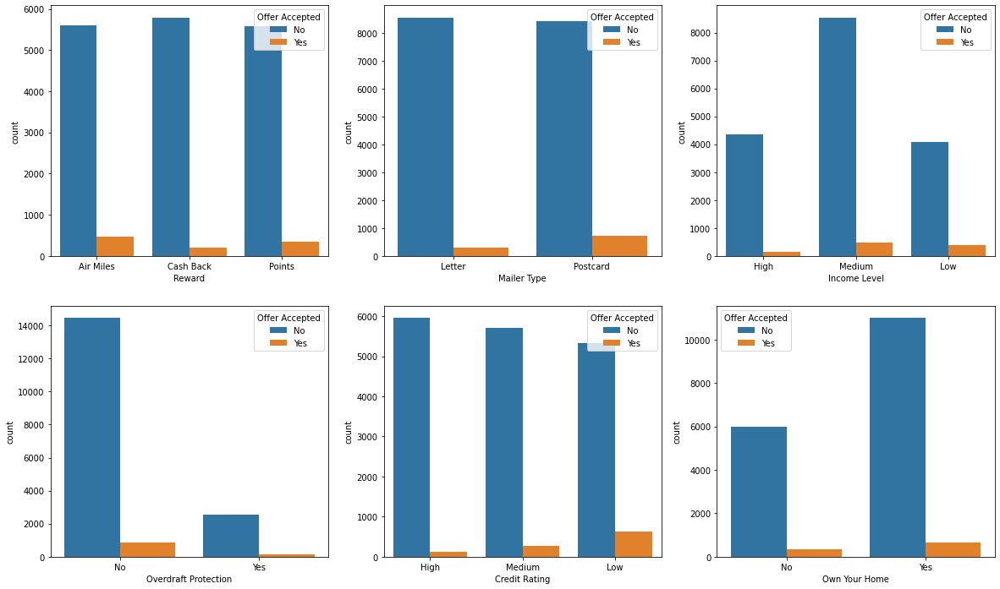

In [68]:
# Exploring numerical data
def plot_categorical_data():
    fig,axes =plt.subplots(2,3,figsize = (20,12))

    sns.countplot(ax = axes[0,0], x='Reward', hue='Offer Accepted',data=df)
    sns.countplot(ax = axes[0,1], x='Mailer Type', hue='Offer Accepted',data=df)
    sns.countplot(ax = axes[0,2], x='Income Level', hue='Offer Accepted',data=df)
    sns.countplot(ax = axes[1,0], x='Overdraft Protection', hue='Offer Accepted',data=df)
    sns.countplot(ax = axes[1,1], x='Credit Rating', hue='Offer Accepted',data=df)
    sns.countplot(ax = axes[1,2], x='Own Your Home', hue='Offer Accepted',data=df)
plot_categorical_data()

> insight visulisasi data categorical
- Responden lebih memilih cashback untuk bagian Reward
- Responden paling banyak income level dimedium
- Responden mayoritas tidak memilih overdraft protection 
- Responden kebanyakan mempunyai credit rating dengan peringkat high
- Responden kebanyakan mempunyai rumah sendiri
- Responden seimbang dalam menerima mailer type

In [69]:
df.columns

Index(['Customer Number', 'Offer Accepted', 'Reward', 'Mailer Type',
       'Income Level', '# Bank Accounts Open', 'Overdraft Protection',
       'Credit Rating', '# Credit Cards Held', '# Homes Owned',
       'Household Size', 'Own Your Home', 'Average Balance', 'Q1 Balance',
       'Q2 Balance', 'Q3 Balance', 'Q4 Balance'],
      dtype='object')

In [70]:
balance = ['Q1 Balance', 'Q2 Balance', 'Q3 Balance', 'Q4 Balance', 'Average Balance']

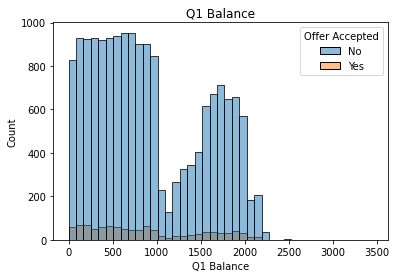

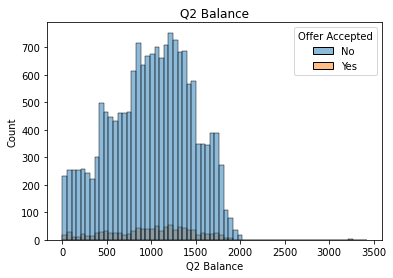

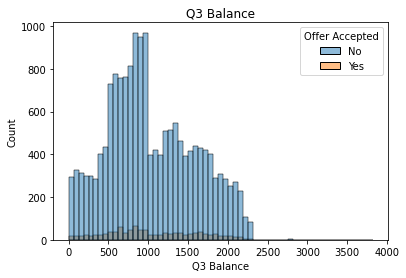

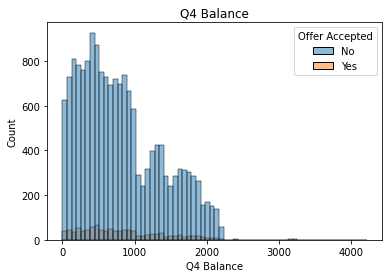

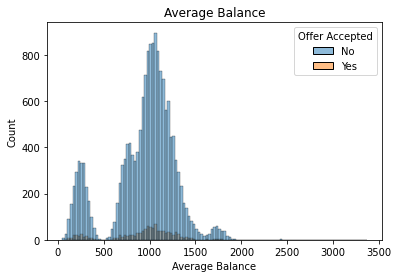

In [71]:
for i in balance:
    plt.figure()
    sns.histplot(x = i, data = df, hue='Offer Accepted')
    plt.title(i)

## 3. Preprocessing

### 3.1 Handling Missing Value

In [72]:
df.head(2)

,Customer Number,Offer Accepted,Reward,Mailer Type,Income Level,# Bank Accounts Open,Overdraft Protection,Credit Rating,# Credit Cards Held,# Homes Owned,Household Size,Own Your Home,Average Balance,Q1 Balance,Q2 Balance,Q3 Balance,Q4 Balance
0,1,No,Air Miles,Letter,High,1,No,High,2,1,4,No,1160.75,1669.0,877.0,1095.0,1002.0
1,2,No,Air Miles,Letter,Medium,1,No,Medium,2,2,5,Yes,147.25,39.0,106.0,78.0,366.0


In [73]:
df_update =df.copy()

In [74]:
df_update['Offer Accepted'] = df_update['Offer Accepted'].replace(['Yes','No'],[1,0])

Kolom yang memiliki missing value adalah kolom yang bertipe data numerical, kita akan mencoba untuk mengisinya dengan mean. Apakah distribusi yang ada akan seimbang atau malah menjadi tambah rusak.

In [75]:
df_update['Q1 Balance'] = df_update['Q1 Balance'].fillna(df_update['Q1 Balance'].median())
df_update['Q2 Balance'] = df_update['Q2 Balance'].fillna(df_update['Q2 Balance'].median())
df_update['Q3 Balance'] = df_update['Q3 Balance'].fillna(df_update['Q3 Balance'].median())
df_update['Q4 Balance'] = df_update['Q4 Balance'].fillna(df_update['Q4 Balance'].median())
df_update['Q1 Balance'] = df_update['Q1 Balance'].fillna(df_update['Q1 Balance'].median())

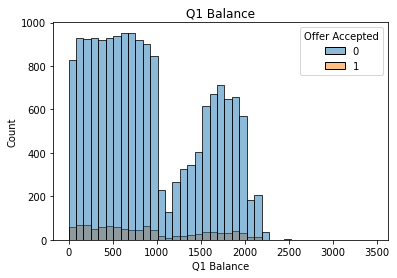

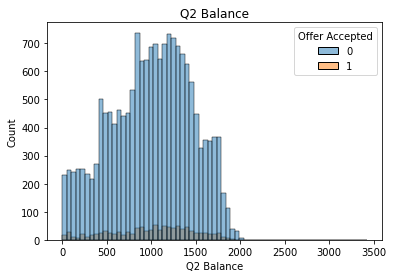

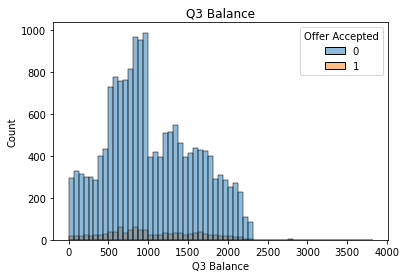

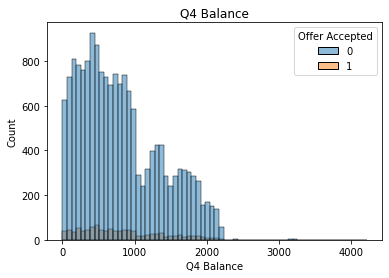

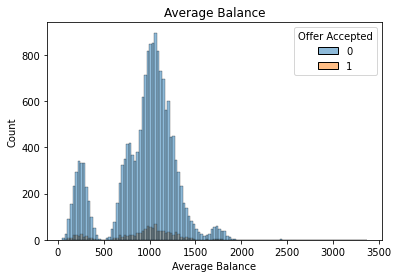

In [76]:
for i in balance:
    plt.figure()
    sns.histplot(x = i, data = df_update, hue='Offer Accepted')
    plt.title(i)

masih kurang pas jika diliat dari distribusi nya

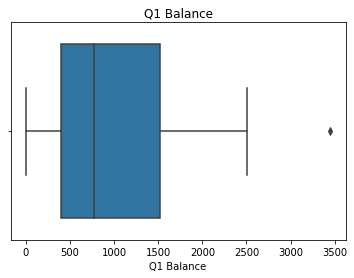

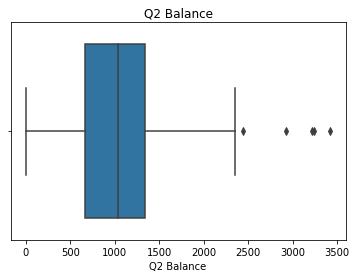

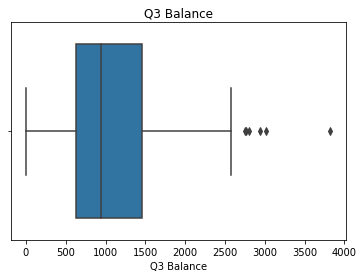

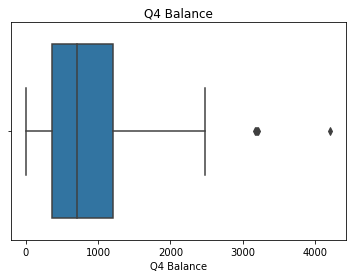

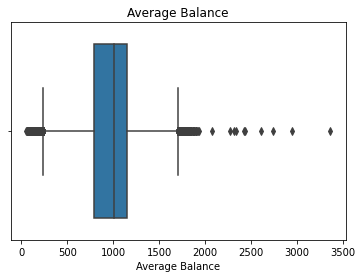

In [77]:
for i in balance:
    plt.figure()
    sns.boxplot(x = i, data = df_update)
    plt.title(i)

In [78]:
df_update2 = df.copy()

In [79]:
df_noncat = df_update2.loc[:, balance] 

In [80]:
df_noncat.head()

,Q1 Balance,Q2 Balance,Q3 Balance,Q4 Balance,Average Balance
0,1669.0,877.0,1095.0,1002.0,1160.75
1,39.0,106.0,78.0,366.0,147.25
2,367.0,352.0,145.0,242.0,276.50
3,1578.0,1760.0,1119.0,419.0,1219.00
4,2140.0,1357.0,982.0,365.0,1211.00


In [81]:
from sklearn.impute import SimpleImputer

In [82]:
SI = SimpleImputer(missing_values = np.nan,strategy='mean')
df_noncat_new = SI.fit_transform(df_noncat)
df_noncat_new = pd.DataFrame(df_noncat_new,columns=df_noncat.columns,index=df_noncat.index)
df_noncat_new.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18000 entries, 0 to 17999
Data columns (total 5 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Q1 Balance       18000 non-null  float64
 1   Q2 Balance       18000 non-null  float64
 2   Q3 Balance       18000 non-null  float64
 3   Q4 Balance       18000 non-null  float64
 4   Average Balance  18000 non-null  float64
dtypes: float64(5)
memory usage: 703.2 KB


In [83]:
df_noncat_new.isnull().sum()

Q1 Balance         0
Q2 Balance         0
Q3 Balance         0
Q4 Balance         0
Average Balance    0
dtype: int64

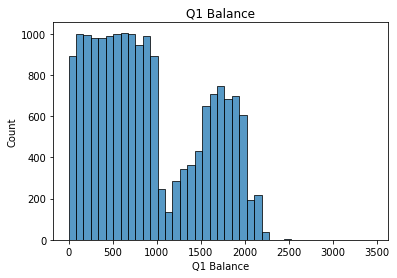

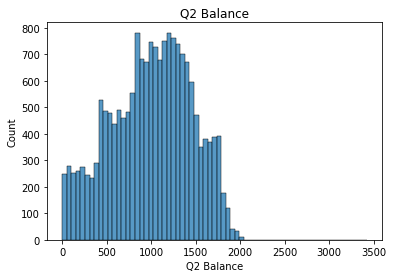

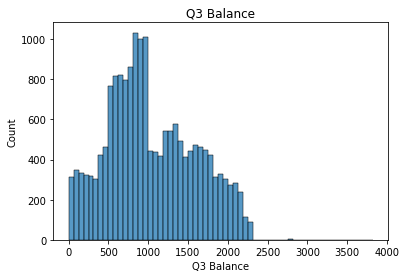

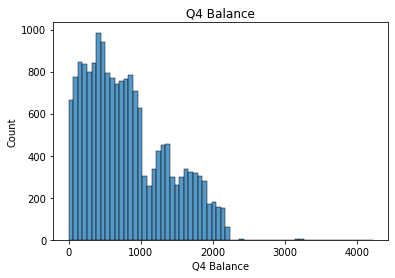

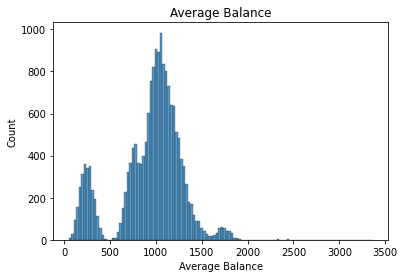

In [84]:
for i in balance:
    plt.figure()
    sns.histplot(x = i, data = df_noncat_new)
    plt.title(i)

kita akan membandingkan antara 2 dataset ini lebih bagus yang mana

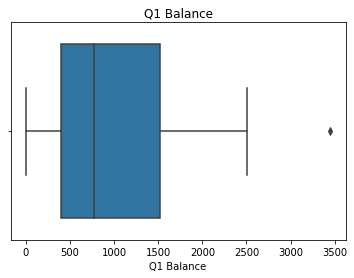

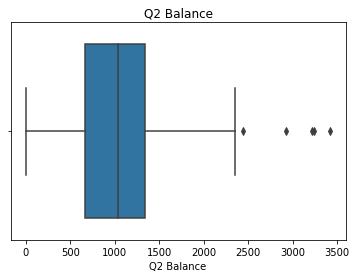

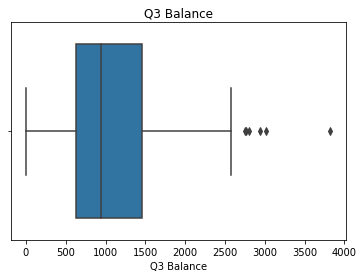

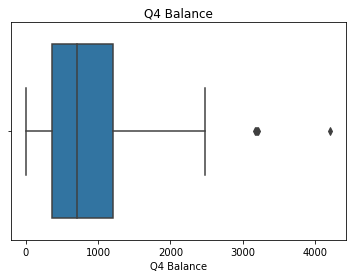

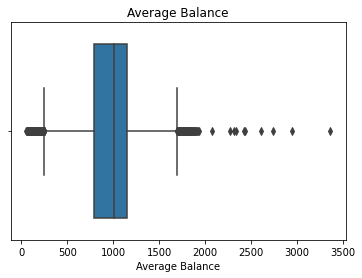

In [85]:
for i in balance:
    plt.figure()
    sns.boxplot(x = i, data = df_noncat_new)
    plt.title(i)

> Kalau diliat dari visualisasi data nya, yang kita masukan data kosong dengan menggunakan simple imputer data nya lebih seimbang distribusinya tapi masih ada beberapa yang kurang seimbang distribusi datanya

In [86]:
df_update2.drop(columns=['Q1 Balance', 'Q2 Balance', 'Q3 Balance', 'Q4 Balance', 'Average Balance'], inplace=True)

In [87]:
df_update2 = pd.concat([df_update2, df_noncat_new],axis=1)


In [88]:
print('Credit Card Maeketing BBM:', df.shape[0], "rows and", df.shape[1],'columns')
print('Credit Card Maeketing BBM:', df_update.shape[0], "rows and", df_update.shape[1],'columns')
print('Credit Card Maeketing BBM:', df_update2.shape[0], "rows and", df_update2.shape[1],'columns')

Credit Card Maeketing BBM: 18000 rows and 17 columns
Credit Card Maeketing BBM: 18000 rows and 17 columns
Credit Card Maeketing BBM: 18000 rows and 17 columns


### 3.2 one hot encoding

In [89]:
df_update2

,Customer Number,Offer Accepted,Reward,Mailer Type,Income Level,# Bank Accounts Open,Overdraft Protection,Credit Rating,# Credit Cards Held,# Homes Owned,Household Size,Own Your Home,Q1 Balance,Q2 Balance,Q3 Balance,Q4 Balance,Average Balance
0,1,No,Air Miles,Letter,High,1,No,High,2,1,4,No,1669.000000,877.00000,1095.0000,1002.000000,1160.750000
1,2,No,Air Miles,Letter,Medium,1,No,Medium,2,2,5,Yes,39.000000,106.00000,78.0000,366.000000,147.250000
2,3,No,Air Miles,Postcard,High,2,No,Medium,2,1,2,Yes,367.000000,352.00000,145.0000,242.000000,276.500000
3,4,No,Air Miles,Letter,Medium,2,No,High,1,1,4,No,1578.000000,1760.00000,1119.0000,419.000000,1219.000000
4,5,No,Air Miles,Letter,Medium,1,No,Medium,2,1,6,Yes,2140.000000,1357.00000,982.0000,365.000000,1211.000000
5,6,No,Air Miles,Letter,Medium,1,No,High,3,1,4,No,1847.000000,1365.00000,750.0000,497.000000,1114.750000
6,7,No,Air Miles,Letter,Medium,1,No,Medium,2,1,3,No,468.000000,188.00000,347.0000,132.000000,283.750000
7,8,No,Cash Back,Postcard,Low,1,No,Medium,4,1,4,Yes,132.000000,391.00000,285.0000,306.000000,278.500000
8,9,No,Air Miles,Postcard,Medium,1,No,Low,2,1,4,Yes,894.000000,891.00000,882.0000,1353.000000,1005.000000
9,10,No,Air Miles,Letter,High,2,No,Low,3,2,4,Yes,1814.000000,1454.00000,514.0000,115.000000,974.250000


In [90]:
from sklearn import preprocessing

# label_encoder object knows how to understand word labels.
label_encoder = preprocessing.LabelEncoder()

df_update2['Offer Accepted']= label_encoder.fit_transform(df_update2['Offer Accepted'])
df_update2['Income Level']= label_encoder.fit_transform(df_update2['Income Level'])
df_update2['Overdraft Protection']= label_encoder.fit_transform(df_update2['Overdraft Protection'])
df_update2['Credit Rating']= label_encoder.fit_transform(df_update2['Credit Rating'])
df_update2['Own Your Home']= label_encoder.fit_transform(df_update2['Own Your Home'])
  


In [91]:
df_update2.head(2)

,Customer Number,Offer Accepted,Reward,Mailer Type,Income Level,# Bank Accounts Open,Overdraft Protection,Credit Rating,# Credit Cards Held,# Homes Owned,Household Size,Own Your Home,Q1 Balance,Q2 Balance,Q3 Balance,Q4 Balance,Average Balance
0,1,0,Air Miles,Letter,0,1,0,0,2,1,4,0,1669.0,877.0,1095.0,1002.0,1160.75
1,2,0,Air Miles,Letter,2,1,0,2,2,2,5,1,39.0,106.0,78.0,366.0,147.25


In [92]:
df_update2 = pd.get_dummies(df_update2, columns=['Reward', 'Mailer Type'])
df_update2.head(2)

,Customer Number,Offer Accepted,Income Level,# Bank Accounts Open,Overdraft Protection,Credit Rating,# Credit Cards Held,# Homes Owned,Household Size,Own Your Home,Q1 Balance,Q2 Balance,Q3 Balance,Q4 Balance,Average Balance,Reward_Air Miles,Reward_Cash Back,Reward_Points,Mailer Type_Letter,Mailer Type_Postcard
0,1,0,0,1,0,0,2,1,4,0,1669.0,877.0,1095.0,1002.0,1160.75,1,0,0,1,0
1,2,0,2,1,0,2,2,2,5,1,39.0,106.0,78.0,366.0,147.25,1,0,0,1,0


### 3.3 Handling Oversampling Target

In [93]:
df_update2['Offer Accepted'].value_counts()

0    16977
1     1023
Name: Offer Accepted, dtype: int64

In [94]:
from sklearn.utils import resample

#create two different dataframe of majority and minority class 
df_majority = df_update2[(df_update2['Offer Accepted']==0)] 
df_minority = df_update2[(df_update2['Offer Accepted']==1)] 
# upsample minority class
df_minority_upsampled = resample(df_minority, 
                                 replace=True,    # sample with replacement
                                 n_samples= 16966, # to match majority class
                                 random_state=20)  # reproducible results
# Combine majority class with upsampled minority class
df_update3 = df_upsampled = pd.concat([df_minority_upsampled, df_majority])

In [95]:
df_update3['Offer Accepted'].value_counts()

0    16977
1    16966
Name: Offer Accepted, dtype: int64

### 3.4 Feature Selection

In [96]:
df_update3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 33943 entries, 6121 to 17999
Data columns (total 20 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Customer Number       33943 non-null  int64  
 1   Offer Accepted        33943 non-null  int32  
 2   Income Level          33943 non-null  int32  
 3   # Bank Accounts Open  33943 non-null  int64  
 4   Overdraft Protection  33943 non-null  int32  
 5   Credit Rating         33943 non-null  int32  
 6   # Credit Cards Held   33943 non-null  int64  
 7   # Homes Owned         33943 non-null  int64  
 8   Household Size        33943 non-null  int64  
 9   Own Your Home         33943 non-null  int32  
 10  Q1 Balance            33943 non-null  float64
 11  Q2 Balance            33943 non-null  float64
 12  Q3 Balance            33943 non-null  float64
 13  Q4 Balance            33943 non-null  float64
 14  Average Balance       33943 non-null  float64
 15  Reward_Air Miles

In [97]:
df_update3.drop(columns=['Customer Number'], inplace=True)
df_update3.head(2)

,Offer Accepted,Income Level,# Bank Accounts Open,Overdraft Protection,Credit Rating,# Credit Cards Held,# Homes Owned,Household Size,Own Your Home,Q1 Balance,Q2 Balance,Q3 Balance,Q4 Balance,Average Balance,Reward_Air Miles,Reward_Cash Back,Reward_Points,Mailer Type_Letter,Mailer Type_Postcard
6121,1,1,1,0,1,2,2,3,0,1512.0,1085.0,819.0,478.0,973.5,1,0,0,0,1
8382,1,2,1,0,1,2,3,2,1,1967.0,1068.0,951.0,468.0,1113.5,0,0,1,0,1


In [98]:
X = df_update3.loc[:, df_update3.columns != 'Offer Accepted']
y = df_update3['Offer Accepted']

In [99]:
# splitting X and y into training and testing sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4,
                                                    random_state=0)

# Modeling

### Logistic Regression

In [100]:
from sklearn.linear_model import LogisticRegression
lr = LogisticRegression()
lr = lr.fit(X_train, y_train)

c:\Users\asus\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



### Random Forest

In [101]:
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier(random_state=42, n_jobs=-1, max_depth=5,
                                       n_estimators=100, oob_score=True)

rf.fit(X_train, y_train)

RandomForestClassifier(max_depth=5, n_jobs=-1, oob_score=True, random_state=42)

In [102]:
rf = RandomForestClassifier(random_state=42, n_jobs=-1)

In [103]:
params = {
    'max_depth': [2,3,5,10,20],
    'min_samples_leaf': [5,10,20,50,100,200],
    'n_estimators': [10,25,30,50,100,200]
}

In [104]:
from sklearn.model_selection import GridSearchCV

# Instantiate the grid search model
grid_search = GridSearchCV(estimator=rf,
                           param_grid=params,
                           cv = 4,
                           n_jobs=-1, verbose=1, scoring="accuracy")

grid_search.fit(X_train, y_train)

Fitting 4 folds for each of 180 candidates, totalling 720 fits


GridSearchCV(cv=4, estimator=RandomForestClassifier(n_jobs=-1, random_state=42),
             n_jobs=-1,
             param_grid={'max_depth': [2, 3, 5, 10, 20],
                         'min_samples_leaf': [5, 10, 20, 50, 100, 200],
                         'n_estimators': [10, 25, 30, 50, 100, 200]},
             scoring='accuracy', verbose=1)

In [105]:
grid_search.best_score_

0.9441687601443207

In [106]:

rf_best = grid_search.best_estimator_
rf_best.fit(X_train, y_train)

RandomForestClassifier(max_depth=20, min_samples_leaf=5, n_estimators=200,
                       n_jobs=-1, random_state=42)

# Evaluation

In [107]:
y_lr = lr.predict(X_test)
y_rf = rf_best.predict(X_test)

### Accuracy

In [108]:
from sklearn.metrics import accuracy_score
print("Accurracy with LR :", accuracy_score(y_test, y_lr))
print("Accurracy with RF :", accuracy_score(y_test, y_rf))

Accurracy with LR : 0.6073059360730594
Accurracy with RF : 0.9620709972013551


### Precision

In [109]:
from sklearn.metrics import precision_score
print("Precision with LR :", precision_score(y_test, y_lr, average='macro'))
print("Precision with RF :", precision_score(y_test, y_rf, average='macro'))

Precision with LR : 0.607359604597888
Precision with RF : 0.963928677209905


### Recall

In [110]:
from sklearn.metrics import recall_score
print("Recall score with LR :", recall_score(y_test, y_lr, average='macro'))
print("Recall score with RF :", recall_score(y_test, y_rf, average='macro'))

Recall score with LR : 0.6073602009586537
Recall score with RF : 0.9623926166685212


### Confusion matrix

In [111]:
from sklearn.metrics import confusion_matrix
print(confusion_matrix(y_test, y_lr))
print(confusion_matrix(y_test, y_rf))

[[4124 2730]
 [2602 4122]]
[[6366  488]
 [  27 6697]]


### Classification Report

In [112]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_lr))
print("=======================================================")
print(classification_report(y_test, y_rf))

              precision    recall  f1-score   support

           0       0.61      0.60      0.61      6854
           1       0.60      0.61      0.61      6724

    accuracy                           0.61     13578
   macro avg       0.61      0.61      0.61     13578
weighted avg       0.61      0.61      0.61     13578

              precision    recall  f1-score   support

           0       1.00      0.93      0.96      6854
           1       0.93      1.00      0.96      6724

    accuracy                           0.96     13578
   macro avg       0.96      0.96      0.96     13578
weighted avg       0.96      0.96      0.96     13578



### ROC  dan AUC

In [113]:
from sklearn.metrics import roc_curve, auc
fpr, tpr, thresholds = roc_curve(y_test, y_lr, pos_label=1) # pos_label: positive label
print(auc(fpr, tpr))
fpr, tpr, thresholds = roc_curve(y_test, y_rf, pos_label=1) # pos_label: positive label
print(auc(fpr, tpr))

0.6073602009586537
0.962392616668521


# conclusion


Melihat dari hasil evalusi kita akan menggunakan logistic regression dikarenakan hasil evaluasi yang cukup bagus, hasil evaluasi dari random forest memiliki hasil yang **overfitting** atau hasil model yang terlalu bagus. Model overfit dapat memberikan prediksi yang tidak akurat dan tidak dapat bekerja dengan baik untuk semua jenis data baru. Project ini masih banyak kekurangan dibagian model yang kurang dieksplorasi dan bagian EDA insight yang didapatkan masih sedikit.